# Simulations
How To simulate
in this notebook we want to give an example how the Ensembler package can be used to simulate systems.

In [1]:
#if package is not installed:
import os, sys
my_path = os.getcwd()+"/.."
sys.path.append(my_path)


import tempfile
import numpy as np
from matplotlib import pyplot as plt
from IPython.display import HTML

%matplotlib inline


#Ensembler
##COde
from ensembler.potentials.OneD import harmonicOscillatorPotential
from ensembler.samplers.stochastic import monteCarloIntegrator, metropolisMonteCarloIntegrator, langevinIntegrator, langevinVelocityIntegrator
from ensembler.samplers.newtonian import positionVerletIntegrator, velocityVerletIntegrator, leapFrogIntegrator
from ensembler.samplers.optimizers import conjugate_gradient
from ensembler.system import system

##Visualisation
from ensembler.visualisation.plotPotentials import plot_1DPotential
from ensembler.visualisation.plotSimulations import static_sim_plots
from ensembler.visualisation.animationSimulation import animation_trajectory, animation_EDS_trajectory


## General Settings

In [2]:
sim_steps=1000

### Define a Potential
Here we define a Potetial, that we want to integrate (you can find more potential Examples in the BasicPotential jupyter notebook).

(<Figure size 243.78x150.664 with 2 Axes>, None)

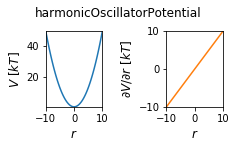

In [3]:
#settings
space_range = [-10, 10]

##Simulation Setup
pot=harmonicOscillatorPotential()

#Visualize
positions = np.linspace(-10,10, 100)
plot_1DPotential(pot, positions=positions)


## Stochastic Integrators

### MonteCarlo  Simulations

Simulation:  Simulation: 100%|██████████| 1000/1000 [00:08<00:00, 119.37it/s]



last_state:  State(position=array(10.30100303), temperature=298.0, total_system_energy=53.055331758420806, total_potential_energy=53.055331758420806, total_kinetic_energy=nan, dhdpos=array(-0.71565034), velocity=nan)
1001


(<Figure size 602.656x150.664 with 3 Axes>, None)

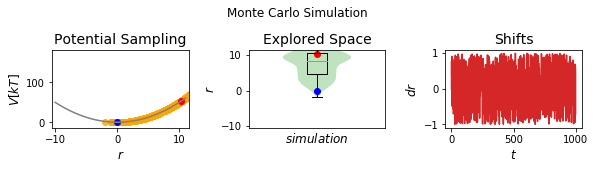

In [4]:
#Build System
sampler = monteCarloIntegrator()
sys=system(potential=pot, sampler=sampler,  start_position=0)

#simulate
cur_state = sys.simulate(sim_steps, withdraw_traj=True)
print()
print("last_state: ", cur_state)
print(len(sys.trajectory))

sys.trajectory.head()

#visualize Simulation in Plot:
static_sim_plots(sys, title="Monte Carlo Simulation", limits_coordinate_space=list(range(-10,11)))

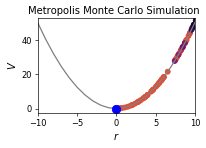

In [5]:
#Show Animation
animation, out_path = animation_trajectory(sys, limits_coordinate_space=space_range, title="Metropolis Monte Carlo Simulation", every_n_frame=10)
animation

### Metropolis Monte Carlo

Simulation:  Simulation: 100%|██████████| 1000/1000 [00:07<00:00, 142.55it/s]



last_state:  State(position=array(-3.1453727), temperature=298.0, total_system_energy=4.946684695782877, total_potential_energy=4.946684695782877, total_kinetic_energy=nan, dhdpos=array(0.33584227), velocity=nan)
1001


(<Figure size 602.656x150.664 with 3 Axes>, None)

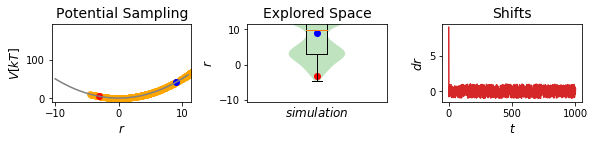

In [6]:
#super easy Metropolis_MonteCarlo simulation
sampler = metropolisMonteCarloIntegrator()
sys=system(potential=pot, sampler=sampler,  start_position=9)

#simulate
cur_state = sys.simulate(sim_steps, withdraw_traj=True)
print()
print("last_state: ", cur_state)
print(len(sys.trajectory))
sys.trajectory.head()

#plot
static_sim_plots(sys, limits_coordinate_space=space_range)

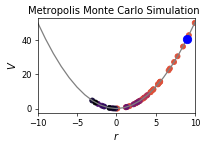

In [7]:
#plot
ani, out_path = animation_trajectory(sys, limits_coordinate_space=space_range, title="Metropolis Monte Carlo Simulation", every_n_frame=10)
ani


## Optimizer - First order Methods

### Conjugated Gradient

Simulation:  Simulation: 100%|██████████| 1000/1000 [00:06<00:00, 161.23it/s]



last_state:  State(position=0.0, temperature=298.0, total_system_energy=0.0, total_potential_energy=0.0, total_kinetic_energy=nan, dhdpos=0.0, velocity=nan)
1001


(<Figure size 602.656x150.664 with 3 Axes>, None)

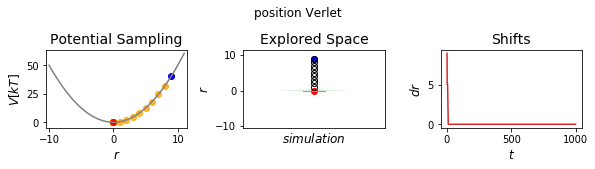

In [8]:
#settings
sampler = conjugate_gradient()
sys=system(potential=pot, sampler=sampler,  start_position=9)

#simulate
cur_state = sys.simulate(sim_steps, withdraw_traj=True)
print()
print("last_state: ", cur_state)
print(len(sys.trajectory))
sys.trajectory.head()

#plot
static_sim_plots(sys, title="position Verlet", limits_coordinate_space=space_range)

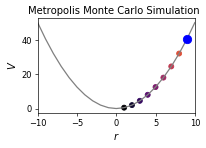

In [9]:
#animation
ani, out_path = animation_trajectory(sys, limits_coordinate_space=space_range, title="Metropolis Monte Carlo Simulation")
ani

## Newtonian Integrators - Second order Methods

### Position Verlet

Simulation:  Simulation: 100%|██████████| 1000/1000 [00:03<00:00, 270.36it/s]


(<Figure size 602.656x150.664 with 3 Axes>, None)

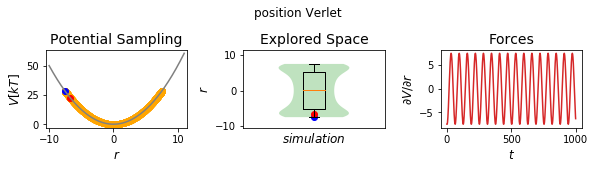

In [10]:
#Simulation Setup
sampler = positionVerletIntegrator(dt=0.1)
sys=system(potential=pot, sampler=sampler, start_position=-7.5)

#simulate
cur_state = sys.simulate(sim_steps, withdraw_traj=True, init_system=False)

sys.trajectory.head()

#plot
static_sim_plots(sys, title="position Verlet", limits_coordinate_space=space_range)

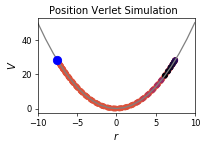

In [11]:
#animation
ani, out_path = animation_trajectory(sys, limits_coordinate_space=space_range, title="Position Verlet Simulation")
ani

### Langevin Integrator

In [2]:
#Simple Langevin integration simulation:
#Thermostat is already included (Langevin thermostat)

#imports
from ensembler.conditions.box_conditions import periodicBoundaryCondition

time_step = 0.2
start_position = 0
temperature = 15
space_range = [-10,10]

#Simulation Setup
pbc = periodicBoundaryCondition(boundary=[space_range])
sampler = langevinIntegrator(dt=time_step, gamma=15, old_Position=0.01)
sys=system(potential=pot, sampler=sampler,  start_position=0,  temperature=temperature, conditions=[pbc])

#simulate
cur_state = sys.simulate(sim_steps, withdraw_traj=True, init_system=False)

print("Trajectory length: ",len(sys.trajectory))
print()
print("last_state: ", cur_state)
print(len(sys.trajectory))
sys.trajectory.head()

##visualize
fig, out_path = static_sim_plots(sys, title="Langevin Simulation")


NameError: name 'pot' is not defined

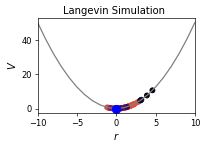

In [13]:
#animation
ani, out_path = animation_trajectory(sys, limits_coordinate_space=space_range, title="Langevin Simulation")
ani

## TwoD potentials

### MonteCarlo

In [4]:
from ensembler.potentials.TwoD import wavePotential
from ensembler.conditions.box_conditions import periodicBoundaryCondition

#super easy Metropolis_MonteCarlo simulation
#settings
space_range = [-180, 180]
sim_steps=100
pbc = periodicBoundaryCondition(boundary=[space_range, space_range])
pot2D=wavePotential(multiplicity=[2,2])
sampler = metropolisMonteCarloIntegrator(minimal_step_size=5)
sys=system(potential=pot2D, sampler=sampler,  conditions=[pbc], start_position=[0,100])

#simulate
cur_state = sys.simulate(sim_steps, withdraw_traj=True)
print()
print("last_state: ", cur_state)
print(len(sys.trajectory))
sys.trajectory.head()


Simulation:  Simulation: 100%|██████████| 100/100 [00:00<00:00, 173.72it/s]


last_state:  State(position=array([110,  20]), temperature=298.0, total_system_energy=array(0.), total_potential_energy=array(0.), total_kinetic_energy=nan, dhdpos=array([-5, -5]), velocity=nan)
101


,position,temperature,total_system_energy,total_potential_energy,total_kinetic_energy,dhdpos,velocity
0,"[0, 100]",298.0,0.06030737921409157,0.06030737921409157,NaN,"[0.0, 0.6840402866513373]",NaN
1,"[5, 95]",298.0,0.0,0.0,NaN,"[5, -5]",NaN
2,"[10, 100]",298.0,0.0,0.0,NaN,"[5, 5]",NaN
3,"[5, 95]",298.0,0.0,0.0,NaN,"[-5, -5]",NaN
4,"[10, 100]",298.0,0.0,0.0,NaN,"[5, 5]",NaN


(10000, 2) (10000, 2)
[2.         1.99195481 1.9679487  ... 1.9679487  1.99195481 2.        ]


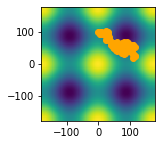

In [6]:

test_timing_with_points=100
positions = np.linspace(-180, 180, test_timing_with_points)
x_positions, y_positions = np.meshgrid(positions,positions)
positions2D = np.array([x_positions.flatten(), y_positions.flatten()]).T
traj_pos = np.array(list(map(lambda x: np.array(x), sys.trajectory.position))).T

plt.imshow(pot2D.ene(positions2D).reshape([test_timing_with_points,test_timing_with_points]), extent=[*space_range, *space_range])
plt.scatter(*traj_pos, color="orange")

### Lagevin

In [7]:
import os, sys
my_path = os.getcwd()+"/.."
print(my_path)
sys.path.append(my_path)

from IPython.display import HTML

import tempfile
import numpy as np
import matplotlib
from matplotlib import pyplot as plt
%matplotlib inline


#Ensembler
##COde
from ensembler.potentials.OneD import harmonicOscillatorPotential
from ensembler.samplers.stochastic import monteCarloIntegrator, metropolisMonteCarloIntegrator, langevinIntegrator, langevinVelocityIntegrator
from ensembler.samplers.newtonian import positionVerletIntegrator, velocityVerletIntegrator, leapFrogIntegrator
from ensembler.samplers.optimizers import conjugate_gradient
from ensembler.system import system

##Visualisation
from ensembler.visualisation.plotSimulations import static_sim_plots
from ensembler.visualisation.animationSimulation import animation_trajectory, animation_EDS_trajectory



C:\Users\benja\OneDrive - ETH Zürich\PhD\Code\ensembler_public\examples/..


In [10]:
from ensembler.potentials.TwoD import wavePotential

#super easy Metropolis_MonteCarlo simulation
#settings
space_range = [-180, 180]
sim_steps=10000
pbc = periodicBoundaryCondition(boundary=[space_range, space_range])
pot2D=wavePotential(multiplicity=[2,2])
sampler = langevinIntegrator(dt=1, gamma=10 , old_Position=[20.01,70.01])
sys=system(potential=pot2D, sampler=sampler,  start_position=[20,70], temperature=1, conditions=[pbc])

#simulate
cur_state = sys.simulate(sim_steps, withdraw_traj=True) #500000, withdraw_traj=True)
print()
print("last_state: ", cur_state)
print(len(sys.trajectory))
sys.trajectory.head()


Simulation:  Simulation: 100%|██████████| 10000/10000 [01:29<00:00, 111.65it/s]


last_state:  State(position=array([94.88101555, 94.04273173]), temperature=1, total_system_energy=array(-1.97557985), total_potential_energy=array(-1.97557985), total_kinetic_energy=nan, dhdpos=array([-0.27911801, -0.20254929]), velocity=None)
10001


,position,temperature,total_system_energy,total_potential_energy,total_kinetic_energy,dhdpos,velocity
0,"[20, 70]",1,0.0062388,1.1102230246251565e-16,0.006239,"[-1.2855752193730785, -1.285575219373079]","[0.10231068456336916, 0.04483429731534331]"
1,"[20.425253578033413, 69.87177998675595]",1,-0.0067410800625516965,-0.0067410800625516965,NaN,"[1.2855752193730785, 1.285575219373079]",None
2,"[21.048554110334294, 68.93955802173588]",1,0.0002782518340993523,0.0002782518340993523,NaN,"[1.3081753068164532, 1.2924195252722106]",None
3,"[19.656469266618156, 70.52743585275775]",1,-0.004051140109366136,-0.004051140109366136,NaN,"[1.3407783395797643, 1.3413940400265296]",None
4,"[19.02547088737368, 69.69281003547653]",1,0.02835510256244944,0.02835510256244944,NaN,"[1.267111210153683, 1.257151672303623]",None


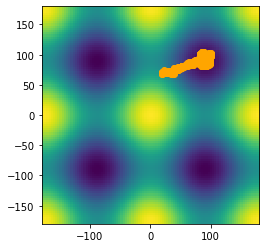

In [12]:
test_timing_with_points=100
positions = np.linspace(-180, 180, test_timing_with_points)
x_positions, y_positions = np.meshgrid(positions,positions)
positions2D = np.array([x_positions.flatten(), y_positions.flatten()]).T

traj_pos = np.array(list(map(lambda x: np.array(x), sys.trajectory.position))).T

plt.imshow(pot2D.ene(positions2D).reshape([test_timing_with_points,test_timing_with_points]), extent=[*space_range,*space_range])
plt.scatter(*traj_pos, color="orange")

### Position Verlet

In [13]:
from ensembler.potentials.TwoD import wavePotential

#super easy Metropolis_MonteCarlo simulation
#settings
space_range = [-180, 180]
pbc = periodicBoundaryCondition(boundary=[space_range, space_range])

sim_steps=1000
pot2D=wavePotential(multiplicity=[2,2])
sampler = positionVerletIntegrator(dt=0.1)
sys=system(potential=pot2D, sampler=sampler,  start_position=[9,9], temperature=1, conditions=[pbc])

#simulate
cur_state = sys.simulate(sim_steps, withdraw_traj=True) 
print()
print("last_state: ", cur_state)
print(len(sys.trajectory))
sys.trajectory.head()


Simulation:  Simulation: 100%|██████████| 1000/1000 [00:12<00:00, 79.95it/s]


last_state:  State(position=array([9.63819724, 9.82819427]), temperature=1, total_system_energy=2.790066105455008, total_potential_energy=array(1.8856639), total_kinetic_energy=0.9044022073085233, dhdpos=array([-0.65451274, -0.66601157]), velocity=array([0.87030923, 1.02536153]))
1001


,position,temperature,total_system_energy,total_potential_energy,total_kinetic_energy,dhdpos,velocity
0,"[9, 9]",1,1.922272,1.902113032590307,0.020159,"[-0.6180339887498948, -0.6180339887498948]","[-0.03579531346135716, 0.19757913514258416]"
1,"[9.002600808541363, 9.025938253401756]",1,1.935783,1.9018047957834154,0.033978,"[-0.6180339887498948, -0.6180339887498948]","[0.026008085413632316, 0.2593825340175736]"
2,"[9.011383683784624, 9.058074066188254]",1,1.956854,1.9013617819423496,0.055492,"[-0.6182066701897287, -0.619755938474007]","[0.08782875243260518, 0.3213581278649743]"
3,"[9.026354456768708, 9.096428765151055]",1,1.985543,1.9007828152338306,0.084760,"[-0.6187897740823062, -0.6218886176303579]","[0.1497077298408358, 0.3835469896280101]"
4,"[9.04752306539898, 9.141027793972604]",1,2.021926,1.9000663596547818,0.121859,"[-0.6197835646188584, -0.6244329858748712]","[0.21168608630272165, 0.44599028821549724]"


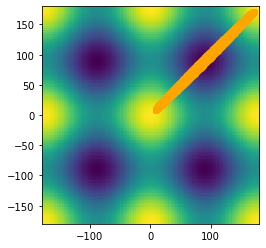

In [14]:
test_timing_with_points=100
positions = np.linspace(-180, 180, test_timing_with_points)
x_positions, y_positions = np.meshgrid(positions,positions)
positions2D = np.array([x_positions.flatten(), y_positions.flatten()]).T

traj_pos = np.array(list(map(lambda x: np.array(x), sys.trajectory.position))).T

plt.imshow(pot2D.ene(positions2D).reshape([test_timing_with_points,test_timing_with_points]), extent=[*space_range, *space_range])
plt.scatter(*traj_pos, color="orange")